In [158]:
import pandas as pd
import numpy as np
from scipy.spatial import cKDTree
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageOps
from skimage.feature import plot_matches
from skimage.measure import ransac
from skimage.transform import AffineTransform
from six import BytesIO
import tensorflow as tf
import tensorflow_hub as hub

In [159]:
# Load
train_features1 = np.load('train_features/10000.npy').item()
train_features2 = np.load('train_features/10000_30000.npy').item()
train_features3 = np.load('train_features/30000_50000.npy').item()
test_features = np.load('test_features/5000.npy').item()

In [171]:
train_features = dict(train_features1.items() + train_features2.items())

In [162]:
train_subset = pd.read_csv('train_subset.csv')
valid_subset = pd.read_csv('validation_subset.csv')

In [172]:
locations_agg = np.concatenate([train_features[img][0] for img in train_features.keys()])
descriptors_agg = np.concatenate([train_features[img][1] for img in train_features.keys()])
accumulated_indexes_boundaries = list(np.cumsum([train_features[img][0].shape[0] for img in train_features.keys()]))

In [173]:
d_tree = cKDTree(descriptors_agg)

In [165]:
def image_index_2_accumulated_indexes(index, accumulated_indexes_boundaries):
    '''
    Image index to accumulated/aggregated locations/descriptors pair indexes.
    '''
    if index > len(accumulated_indexes_boundaries) - 1:
        return None
    accumulated_index_start = None
    accumulated_index_end = None
    if index == 0:
        accumulated_index_start = 0
        accumulated_index_end = accumulated_indexes_boundaries[index]
    else:
        accumulated_index_start = accumulated_indexes_boundaries[index-1]
        accumulated_index_end = accumulated_indexes_boundaries[index]
    return np.arange(accumulated_index_start,accumulated_index_end)

In [30]:
def get_locations_2_use(image_db_index, k_nearest_indices, accumulated_indexes_boundaries):
    '''
    Get a pair of locations to use, the query image to the database image with given index.
    Return: a tuple of 2 numpy arrays, the locations pair.
    '''
    image_accumulated_indexes = image_index_2_accumulated_indexes(image_db_index, accumulated_indexes_boundaries)
    locations_2_use_query = []
    locations_2_use_db = []
    for i, row in enumerate(k_nearest_indices):
        for acc_index in row:
            if acc_index in image_accumulated_indexes:
                locations_2_use_query.append(query_image_locations[i])
                locations_2_use_db.append(locations_agg[acc_index])
                break
    return np.array(locations_2_use_query), np.array(locations_2_use_db)

In [174]:
import scandir
import os
db_images = []
for entry in scandir.scandir('train_image'):
    if entry.is_file():
        db_images.append(os.path.join('train_image', entry.name))

Match between two images 

Loaded image 1's 101 features
Loaded image 2's 72 features
Found 21 inliers


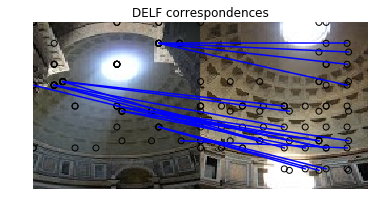

In [118]:
image_1_path = test_features.keys()[21]
image_2_path = 'apm/train_image/aa7a53c424aa140a.jpg'


def match_images(results_dict1, results_dict2, image_1_path, image_2_path):
    distance_threshold = 50
   
    # Read features.
    locations_1, descriptors_1 = results_dict1[image_1_path]
    num_features_1 = locations_1.shape[0]
    print("Loaded image 1's %d features" % num_features_1)
    locations_2, descriptors_2 = results_dict2['apm/train_image/aa7a53c424aa140a.jpg']
    num_features_2 = locations_2.shape[0]
    print("Loaded image 2's %d features" % num_features_2)

    # Find nearest-neighbor matches using a KD tree.
    d1_tree = cKDTree(descriptors_1)
    _, indices = d1_tree.query(
        descriptors_2, distance_upper_bound=distance_threshold)

  # Select feature locations for putative matches.
    locations_2_to_use = np.array([
        locations_2[i,]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])
    locations_1_to_use = np.array([
        locations_1[indices[i],]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])

  # Perform geometric verification using RANSAC.
    _, inliers = ransac(
        (locations_1_to_use, locations_2_to_use),
        AffineTransform,
        min_samples=3,
        residual_threshold=20,
        max_trials=1000)
    # the number of inliers as the score for retrieved images.
    print('Found %d inliers' % sum(inliers))

    # Visualize correspondences.
    _, ax = plt.subplots()
    img_1 = mpimg.imread(image_1_path[4:])
    img_2 = mpimg.imread(image_2_path)
    inlier_idxs = np.nonzero(inliers)[0]
    plot_matches(
        ax,
        img_1,
        img_2,
        locations_1_to_use,
        locations_2_to_use,
        np.column_stack((inlier_idxs, inlier_idxs)),
        matches_color='b')
    ax.axis('off')
    ax.set_title('DELF correspondences')
    plt.show()

match_images(test_features, train_features, test_features.keys()[21],'train_image/81ea4b3895a9f777.jpg')

Use only 30,000 training images here

Found 24 inliers
[6696] [13526] [False]
Found inliers for image 27875 -> 24
matched count 0


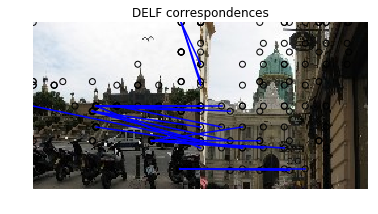

Found 33 inliers
[9633] [13653] [False]
Found inliers for image 21004 -> 33
matched count 0


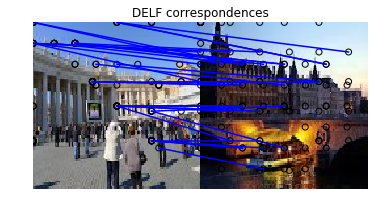

Found 39 inliers
[6051] [6051] [ True]
Found inliers for image 10591 -> 39
matched count 1


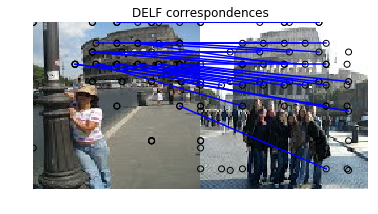

Found 54 inliers
[5554] [5554] [ True]
Found inliers for image 28628 -> 54
matched count 2


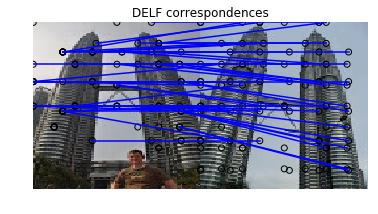

Found 30 inliers
[5554] [5554] [ True]
Found inliers for image 18916 -> 30
matched count 3


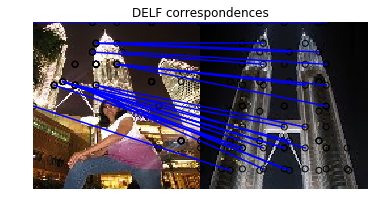

Found 37 inliers
[10577] [1553] [False]
Found inliers for image 3655 -> 37
matched count 3


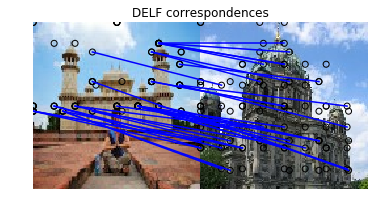

Found 28 inliers
[4644] [11249] [False]
Found inliers for image 4703 -> 28
matched count 3


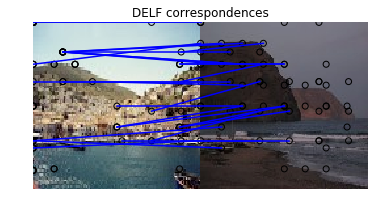

Found 30 inliers
[9029] [1553] [False]
Found inliers for image 27897 -> 30
matched count 3


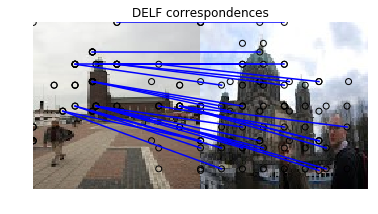

Found 26 inliers
[9779] [13653] [False]
Found inliers for image 9489 -> 26
matched count 3


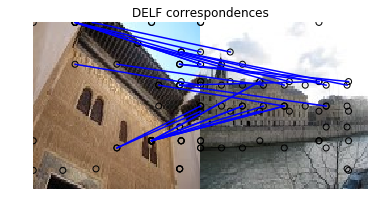

Found 33 inliers
[9633] [2743] [False]
Found inliers for image 6412 -> 33
matched count 3


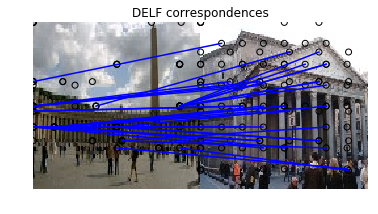

Found 28 inliers
[6651] [10577] [False]
Found inliers for image 4543 -> 28
matched count 3


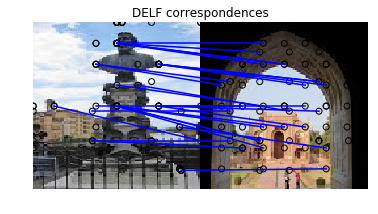

Found 33 inliers
[9605] [13444] [False]
Found inliers for image 13627 -> 33
matched count 3


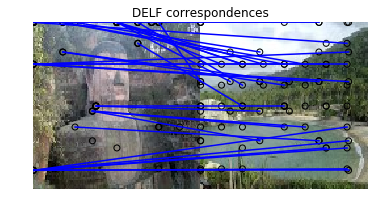

Found 31 inliers
[2061] [2061] [ True]
Found inliers for image 230 -> 31
matched count 4


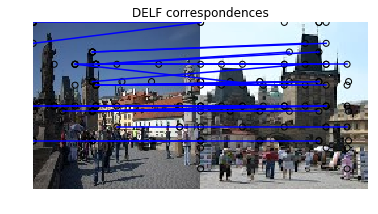

Found 46 inliers
[9633] [9633] [ True]
Found inliers for image 8244 -> 46
matched count 5


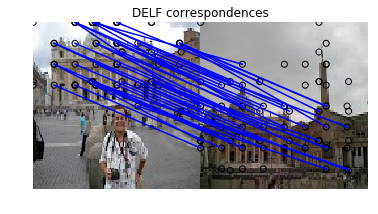

Found 38 inliers
[9633] [9633] [ True]
Found inliers for image 28383 -> 38
matched count 6


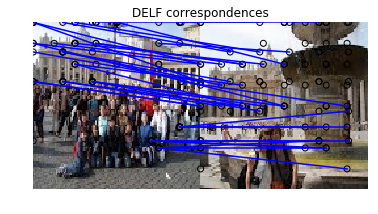

Found 24 inliers
[2949] [6599] [False]
Found inliers for image 26867 -> 24
matched count 6


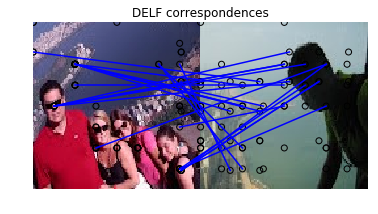

Found 37 inliers
[8063] [8063] [ True]
Found inliers for image 28083 -> 37
matched count 7


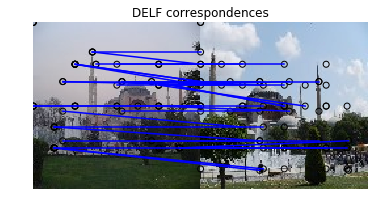

Found 38 inliers
[5554] [5554] [ True]
Found inliers for image 28628 -> 38
matched count 8


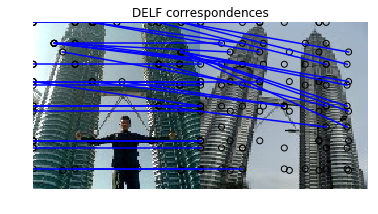

Found 40 inliers
[6051] [6051] [ True]
Found inliers for image 29820 -> 40
matched count 9


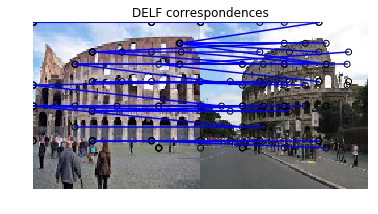

Found 26 inliers
[2044] [12220] [False]
Found inliers for image 1661 -> 26
matched count 9


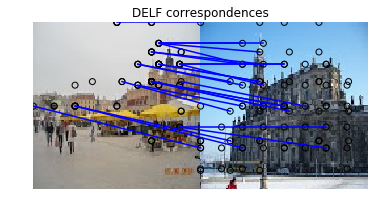

Found 28 inliers
[2338] [2338] [ True]
Found inliers for image 23198 -> 28
matched count 10


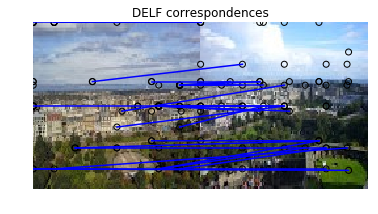

Found 25 inliers
[2743] [1602] [False]
Found inliers for image 5008 -> 25
matched count 10


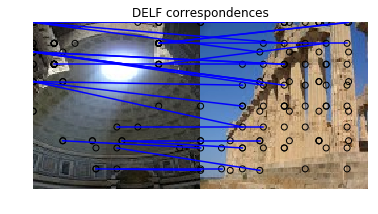

Found 23 inliers
[3497] [13526] [False]
Found inliers for image 12397 -> 23
matched count 10


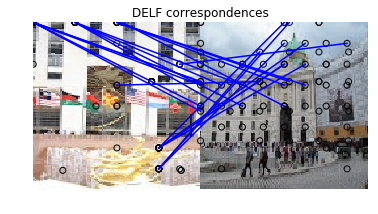

Found 30 inliers
[4981] [11371] [False]
Found inliers for image 20688 -> 30
matched count 10


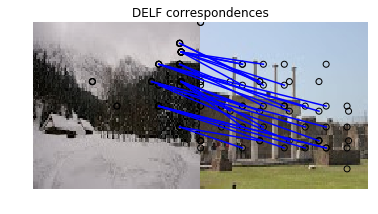

Found 26 inliers
[2061] [13170] [False]
Found inliers for image 21072 -> 26
matched count 10


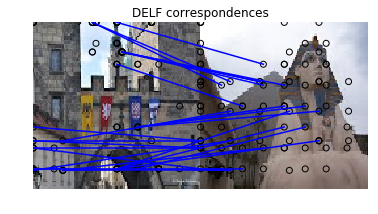

Found 32 inliers
[13876] [4352] [False]
Found inliers for image 16086 -> 32
matched count 10


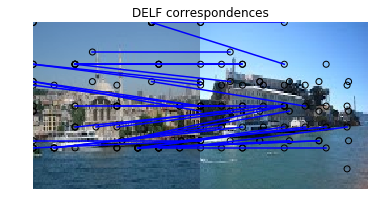

Found 27 inliers
[10900] [2061] [False]
Found inliers for image 13061 -> 27
matched count 10


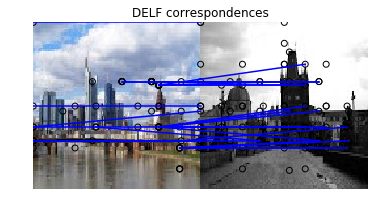

Found 33 inliers
[10577] [1553] [False]
Found inliers for image 6803 -> 33
matched count 10


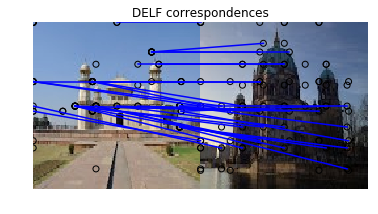

Found 29 inliers
[5554] [7661] [False]
Found inliers for image 23149 -> 29
matched count 10


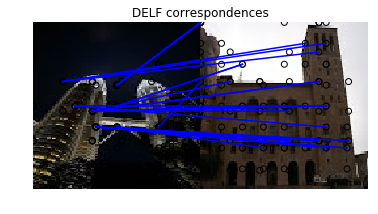

Found 28 inliers
[8063] [9633] [False]
Found inliers for image 22467 -> 28
matched count 10


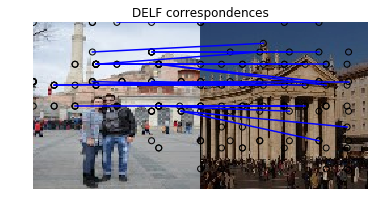

Found 30 inliers
[9779] [1553] [False]
Found inliers for image 29714 -> 30
matched count 10


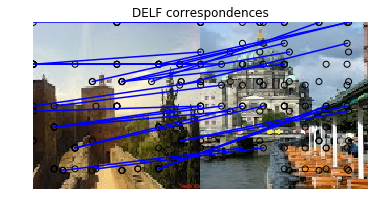

Found 41 inliers
[6051] [6051] [ True]
Found inliers for image 8331 -> 41
matched count 11


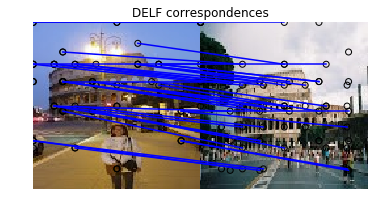

Found 31 inliers
[6051] [6051] [ True]
Found inliers for image 8168 -> 31
matched count 12


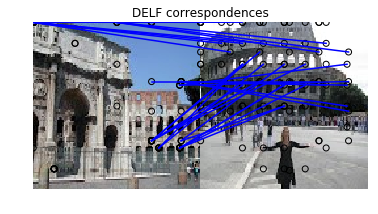

Found 33 inliers
[11784] [12718] [False]
Found inliers for image 8341 -> 33
matched count 12


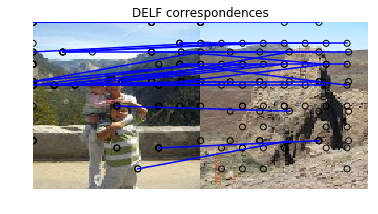

Found 26 inliers
[11371] [6051] [False]
Found inliers for image 25572 -> 26
matched count 12


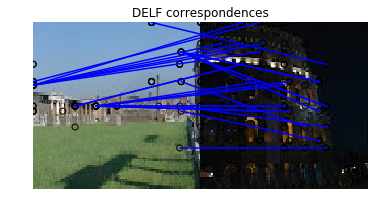

Found 39 inliers
[9633] [6597] [False]
Found inliers for image 21060 -> 39
matched count 12


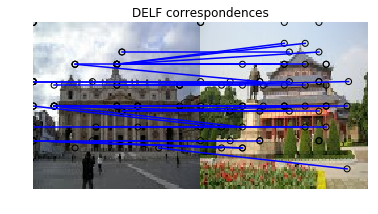

Found 30 inliers
[9633] [6051] [False]
Found inliers for image 29931 -> 30
matched count 12


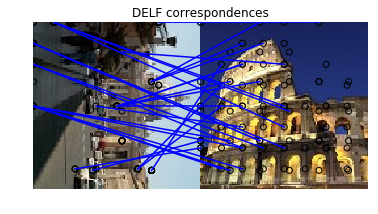

Found 28 inliers
[6051] [9779] [False]
Found inliers for image 21132 -> 28
matched count 12


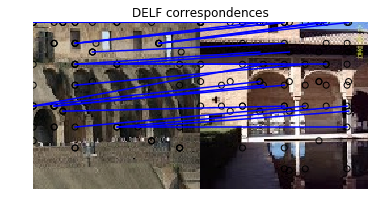

Found 26 inliers
[1946] [5554] [False]
Found inliers for image 13674 -> 26
matched count 12


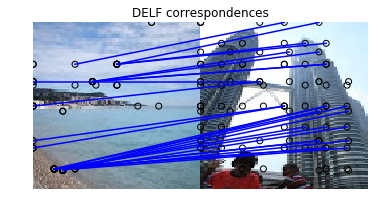

Found 34 inliers
[9633] [9633] [ True]
Found inliers for image 23580 -> 34
matched count 13


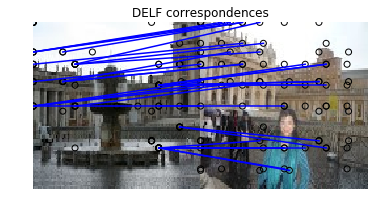

Found 30 inliers
[1472] [8169] [False]
Found inliers for image 19379 -> 30
matched count 13


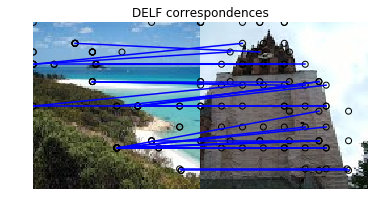

Found 25 inliers
[5460] [1553] [False]
Found inliers for image 19540 -> 25
matched count 13


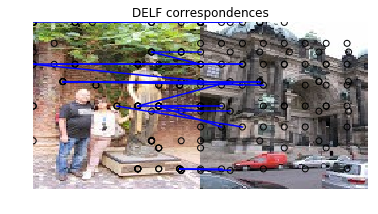

Found 31 inliers
[3130] [6051] [False]
Found inliers for image 7189 -> 31
matched count 13


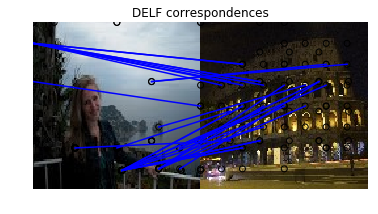

Found 42 inliers
[8429] [8429] [ True]
Found inliers for image 26929 -> 42
matched count 14


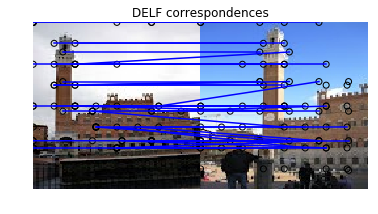

Found 25 inliers
[5166] [10033] [False]
Found inliers for image 3745 -> 25
matched count 14


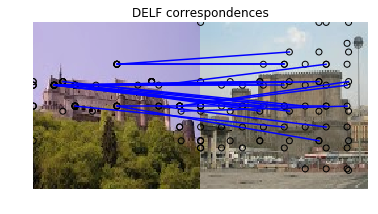

Found 28 inliers
[6651] [9633] [False]
Found inliers for image 21587 -> 28
matched count 14


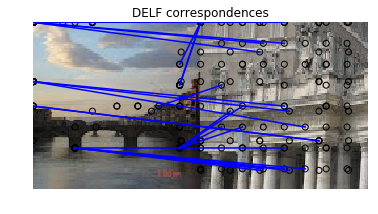

Found 35 inliers
[9779] [9779] [ True]
Found inliers for image 6765 -> 35
matched count 15


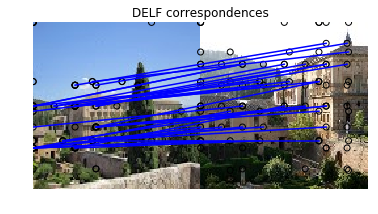

Found 42 inliers
[10045] [10045] [ True]
Found inliers for image 26470 -> 42
matched count 16


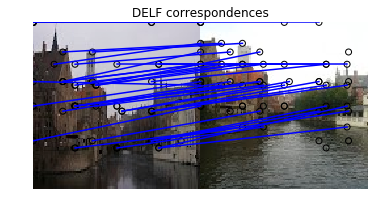

Found 28 inliers
[12220] [9633] [False]
Found inliers for image 22815 -> 28
matched count 16


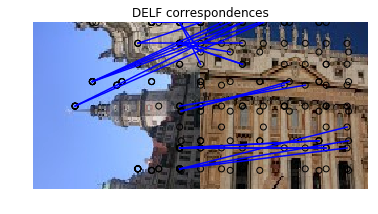

Found 33 inliers
[11371] [6051] [False]
Found inliers for image 28190 -> 33
matched count 16


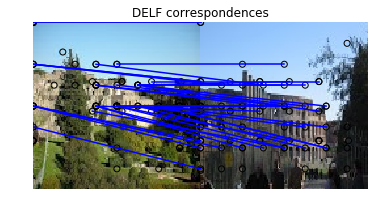

Found 28 inliers
[1878] [6051] [False]
Found inliers for image 29798 -> 28
matched count 16


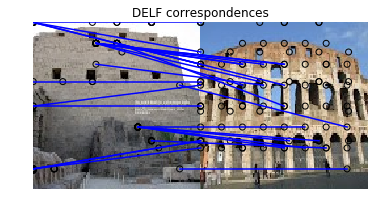

Found 34 inliers
[8429] [10900] [False]
Found inliers for image 29417 -> 34
matched count 16


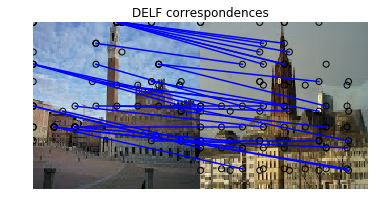

Found 31 inliers
[10511] [6599] [False]
Found inliers for image 5753 -> 31
matched count 16


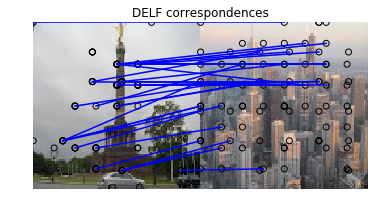

Found 33 inliers
[9779] [2743] [False]
Found inliers for image 24243 -> 33
matched count 16


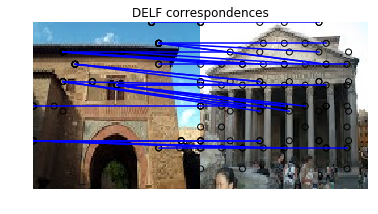

Found 33 inliers
[10026] [10026] [ True]
Found inliers for image 15761 -> 33
matched count 17


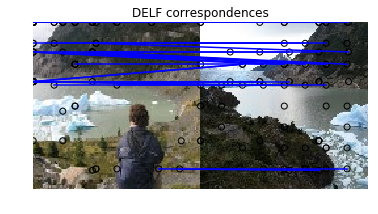

Found 32 inliers
[2061] [9633] [False]
Found inliers for image 3293 -> 32
matched count 17


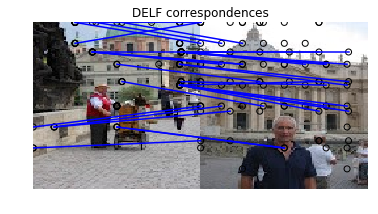

Found 27 inliers
[428] [9633] [False]
Found inliers for image 5017 -> 27
matched count 17


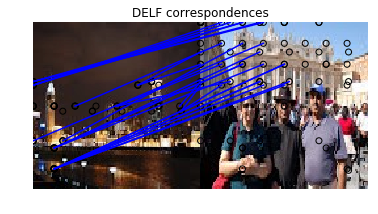

Found 36 inliers
[4352] [4352] [ True]
Found inliers for image 10302 -> 36
matched count 18


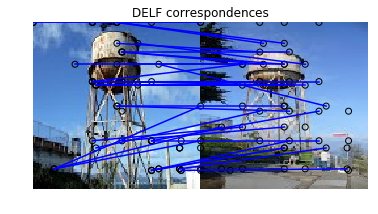

Found 28 inliers
[428] [6696] [False]
Found inliers for image 1660 -> 28
matched count 18


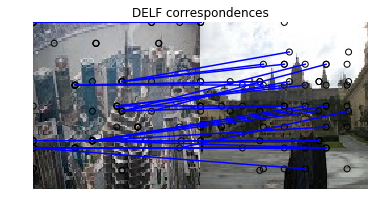

Found 31 inliers
[2338] [6599] [False]
Found inliers for image 27116 -> 31
matched count 18


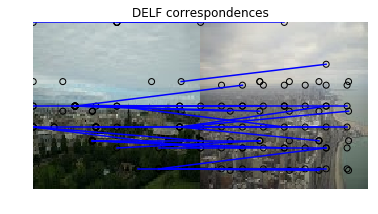

Found 37 inliers
[7041] [6599] [False]
Found inliers for image 19791 -> 37
matched count 18


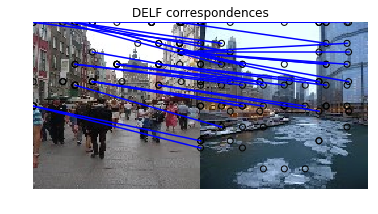

Found 28 inliers
[2061] [6599] [False]
Found inliers for image 21505 -> 28
matched count 18


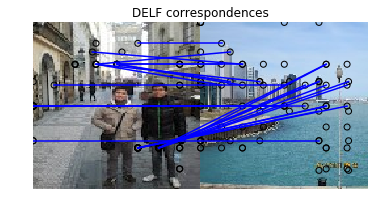

Found 28 inliers
[8429] [2743] [False]
Found inliers for image 6443 -> 28
matched count 18


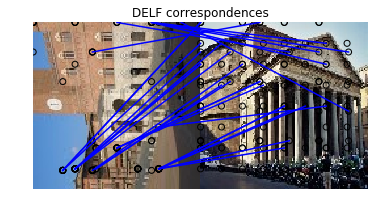

Found 26 inliers
[6599] [9779] [False]
Found inliers for image 13312 -> 26
matched count 18


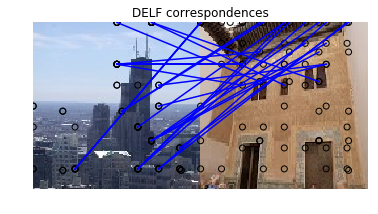

Found 29 inliers
[9633] [9633] [ True]
Found inliers for image 15344 -> 29
matched count 19


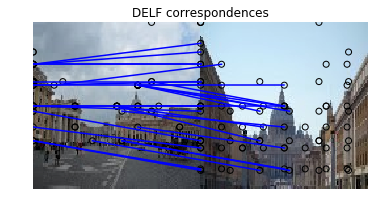

Found 30 inliers
[6051] [6051] [ True]
Found inliers for image 14232 -> 30
matched count 20


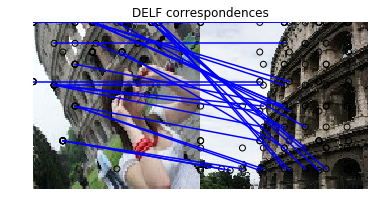

Found 29 inliers
[8429] [6599] [False]
Found inliers for image 21252 -> 29
matched count 20


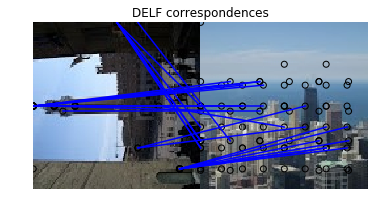

Found 38 inliers
[13526] [13526] [ True]
Found inliers for image 29008 -> 38
matched count 21


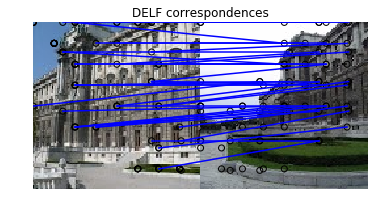

Found 25 inliers
[6051] [4352] [False]
Found inliers for image 8507 -> 25
matched count 21


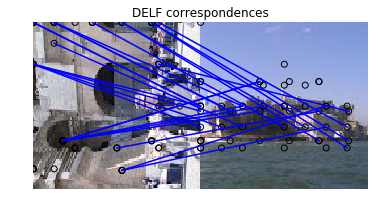

Found 31 inliers
[5376] [9633] [False]
Found inliers for image 19760 -> 31
matched count 21


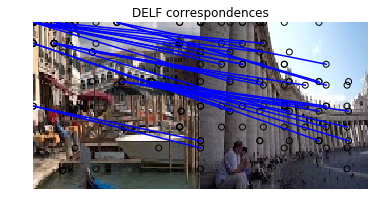

Found 34 inliers
[1553] [13526] [False]
Found inliers for image 27754 -> 34
matched count 21


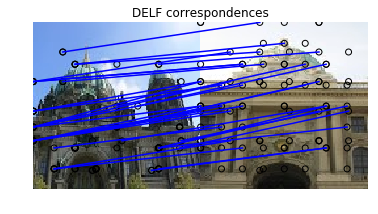

Found 25 inliers
[3804] [6051] [False]
Found inliers for image 11531 -> 25
matched count 21


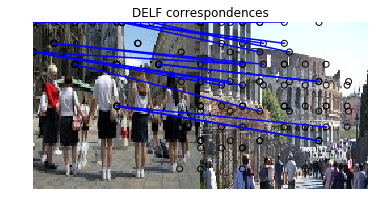

Found 32 inliers
[12718] [6231] [False]
Found inliers for image 26963 -> 32
matched count 21


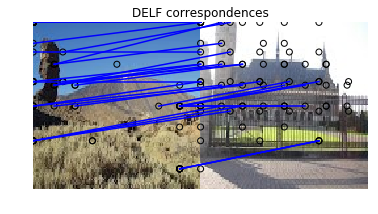

Found 29 inliers
[1553] [13873] [False]
Found inliers for image 29941 -> 29
matched count 21


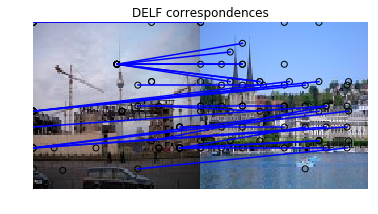

Found 42 inliers
[4987] [4987] [ True]
Found inliers for image 15051 -> 42
matched count 22


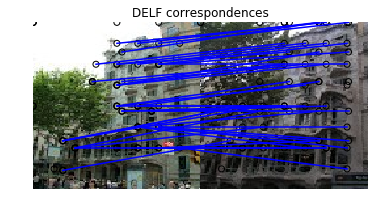

Found 53 inliers
[6599] [6599] [ True]
Found inliers for image 20919 -> 53
matched count 23


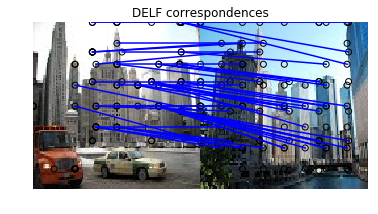

Found 40 inliers
[9633] [9633] [ True]
Found inliers for image 14969 -> 40
matched count 24


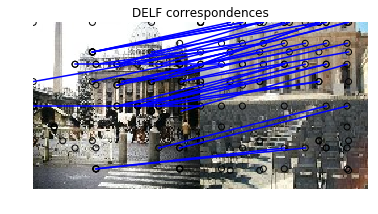

Found 31 inliers
[6051] [6051] [ True]
Found inliers for image 29702 -> 31
matched count 25


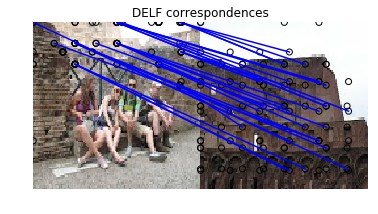

Found 31 inliers
[12220] [9633] [False]
Found inliers for image 158 -> 31
matched count 25


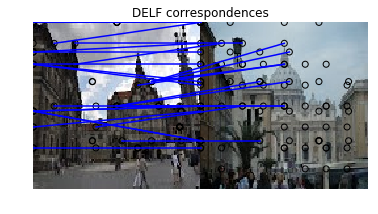

Found 44 inliers
[9633] [9633] [ True]
Found inliers for image 21259 -> 44
matched count 26


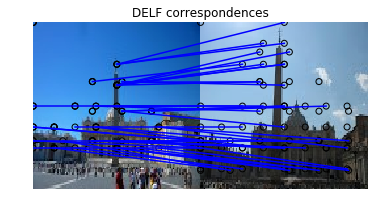

Found 25 inliers
[10045] [6597] [False]
Found inliers for image 20231 -> 25
matched count 26


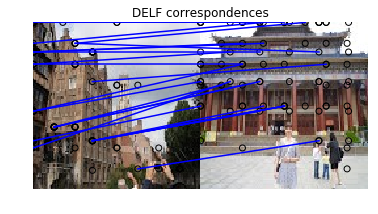

Found 49 inliers
[9633] [9633] [ True]
Found inliers for image 19093 -> 49
matched count 27


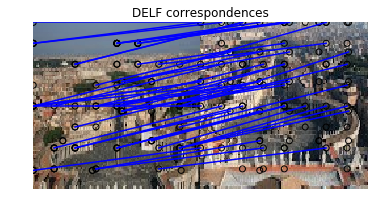

Found 25 inliers
[4352] [9633] [False]
Found inliers for image 26476 -> 25
matched count 27


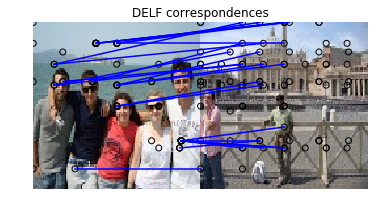

Found 42 inliers
[9633] [9633] [ True]
Found inliers for image 17291 -> 42
matched count 28


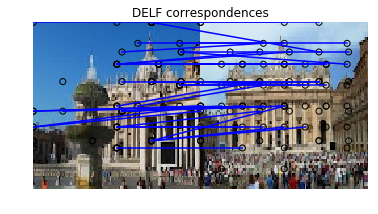

Found 30 inliers
[8429] [2743] [False]
Found inliers for image 4218 -> 30
matched count 28


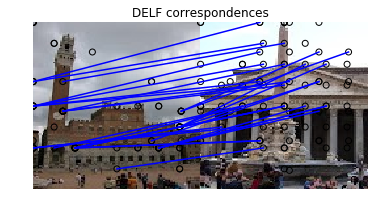

Found 37 inliers
[6051] [9779] [False]
Found inliers for image 24966 -> 37
matched count 28


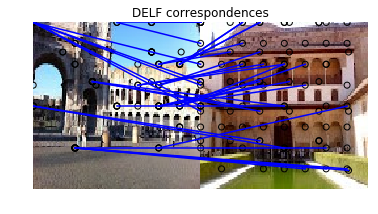

Found 35 inliers
[2241] [9633] [False]
Found inliers for image 1676 -> 35
matched count 28


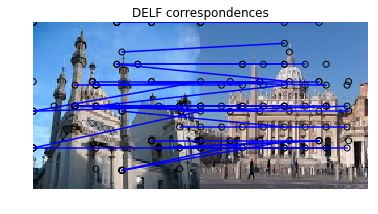

Found 24 inliers
[13475] [6476] [False]
Found inliers for image 20804 -> 24
matched count 28


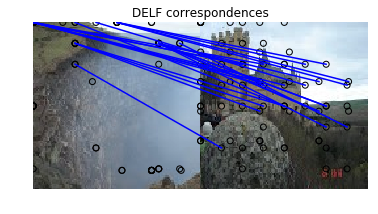

Found 35 inliers
[10900] [9633] [False]
Found inliers for image 5541 -> 35
matched count 28


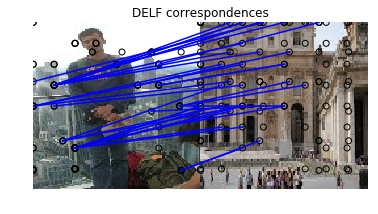

Found 27 inliers
[4352] [9633] [False]
Found inliers for image 7933 -> 27
matched count 28


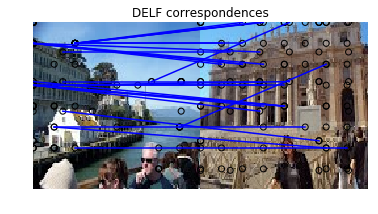

Found 29 inliers
[6051] [6051] [ True]
Found inliers for image 793 -> 29
matched count 29


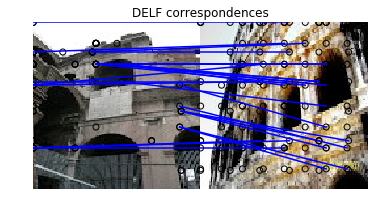

Found 23 inliers
[1602] [9633] [False]
Found inliers for image 17505 -> 23
matched count 29


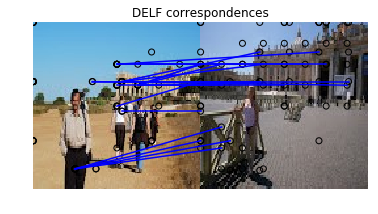

Found 30 inliers
[6051] [9434] [False]
Found inliers for image 23347 -> 30
matched count 29


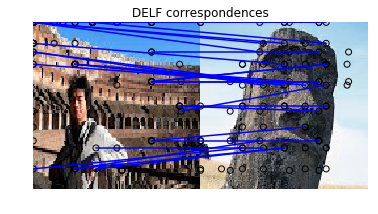

Found 32 inliers
[9779] [2743] [False]
Found inliers for image 27079 -> 32
matched count 29


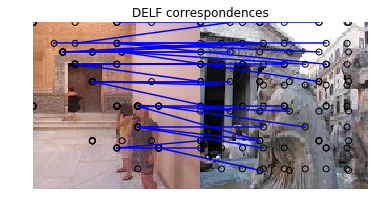

Found 29 inliers
[11371] [2449] [False]
Found inliers for image 657 -> 29
matched count 29


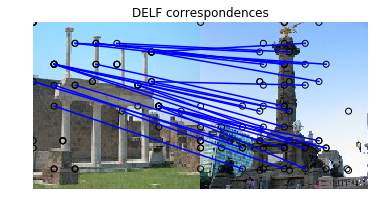

Found 31 inliers
[10045] [10045] [ True]
Found inliers for image 14387 -> 31
matched count 30


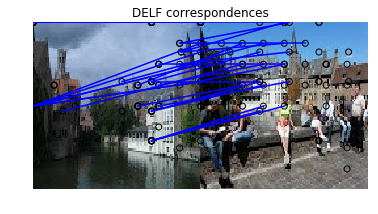

Found 34 inliers
[12220] [9633] [False]
Found inliers for image 25696 -> 34
matched count 30


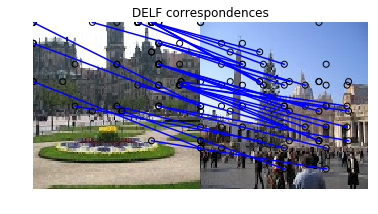

Found 28 inliers
[5554] [2949] [False]
Found inliers for image 6800 -> 28
matched count 30


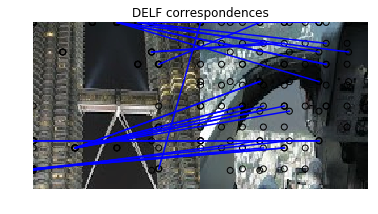

Found 36 inliers
[9633] [9633] [ True]
Found inliers for image 8919 -> 36
matched count 31


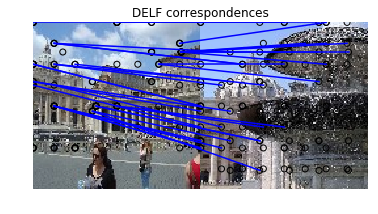

Found 41 inliers
[9633] [9633] [ True]
Found inliers for image 7030 -> 41
matched count 32


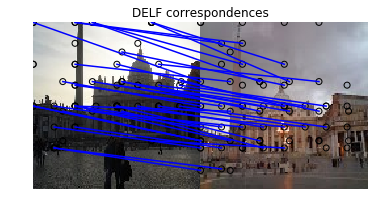

In [175]:
results_dict1=test_features
results_dict2=train_features
distance_threshold = 1.5
matched = 0
for i in range(100):
    image_1_path = test_features.keys()[i]
    inliers_counts = []
    locations_1, descriptors_1 = results_dict1[image_1_path]    
    distances, indices = d_tree.query(descriptors_1, distance_upper_bound=distance_threshold, n_jobs=-1, k=3)

    # Find the list of unique accumulated/aggregated indexes
    unique_indices = np.array(list(set(indices.flatten())))

    unique_indices.sort()
    if unique_indices[-1] == descriptors_agg.shape[0]:
        unique_indices = unique_indices[:-1]
    unique_image_indexes = np.array(list(set([np.argmax([np.array(accumulated_indexes_boundaries)>index]) 
              for index in unique_indices])))
      
    for index in unique_image_indexes:
        image_2_path=db_images[index]

        # Read features.
        locations_1, descriptors_1 = results_dict1[image_1_path]
        num_features_1 = locations_1.shape[0]
        locations_2, descriptors_2 = results_dict2[os.path.join('apm', image_2_path)]
        num_features_2 = locations_2.shape[0]
        #print("Loaded image 2's %d features" % num_features_2)

        # Find nearest-neighbor matches using a KD tree.
        d1_tree = cKDTree(descriptors_1)
        _, indices = d1_tree.query(
            descriptors_2, distance_upper_bound=distance_threshold)

      # Select feature locations for putative matches.
        locations_2_to_use = np.array([
        locations_2[i,]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])
        locations_1_to_use = np.array([
        locations_1[indices[i],]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])

      # Perform geometric verification using RANSAC.
   
        _, inliers = ransac(
        (locations_1_to_use, locations_2_to_use),
        AffineTransform,
        min_samples=3,
        residual_threshold=20,
        max_trials=1000)
        # the number of inliers as the score for retrieved images.
        
        inliers_counts.append({"index": index, "inliers": sum(inliers)})

    top_match = sorted(inliers_counts, key=lambda k: k['inliers'], reverse=True)[0]
    index = top_match['index']
    inliers = top_match['inliers']
    image_2_path = db_images[index]
    locations_2, descriptors_2 = results_dict2[os.path.join('apm', db_images[index])]
    num_features_2 = locations_2.shape[0]
    # Find nearest-neighbor matches using a KD tree.
    d1_tree = cKDTree(descriptors_1)
    _, indices = d1_tree.query(
        descriptors_2, distance_upper_bound=distance_threshold)

    # Select feature locations for putative matches.
    locations_2_to_use = np.array([
        locations_2[i,]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])
    locations_1_to_use = np.array([
        locations_1[indices[i],]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])

    # Perform geometric verification using RANSAC.
    _, inliers = ransac(
        (locations_1_to_use, locations_2_to_use),
        AffineTransform,
        min_samples=3,
        residual_threshold=20,
        max_trials=1000)
    # the number of inliers as the score for retrieved images.
    print('Found %d inliers' % sum(inliers))

    # find the true label
    mask = valid_subset['id'] == image_1_path[21:37]
    true_label = valid_subset[mask]['landmark_id'].values
        
    # find the predicted label
    mask = train_subset['id'] == db_images[index][12:28]
    predicted_label = train_subset[mask]['landmark_id'].values
    
    print true_label, predicted_label, true_label == predicted_label
    
    print('Found inliers for image {} -> {}').format(index, sum(inliers))
    if true_label == predicted_label:
        matched +=1
    print "matched count", matched
    # Visualize correspondences.
    _, ax = plt.subplots()
    img_1 = mpimg.imread(image_1_path[4:])
    img_2 = mpimg.imread(image_2_path)
    inlier_idxs = np.nonzero(inliers)[0]
    plot_matches(
        ax,
        img_1,
        img_2,
        locations_1_to_use,
        locations_2_to_use,
        np.column_stack((inlier_idxs, inlier_idxs)),
        matches_color='b')
    ax.axis('off')
    ax.set_title('DELF correspondences')
    plt.show()

Use 50,000 training images here.

In [176]:
train_features = dict(train_features1.items() + train_features2.items() + train_features3.items())
locations_agg = np.concatenate([train_features[img][0] for img in train_features.keys()])
descriptors_agg = np.concatenate([train_features[img][1] for img in train_features.keys()])
accumulated_indexes_boundaries = list(np.cumsum([train_features[img][0].shape[0] for img in train_features.keys()]))
d_tree = cKDTree(descriptors_agg)

Found 30 inliers
[6696] [12220] [False]
Found inliers for image 8896 -> 30
matched count 0


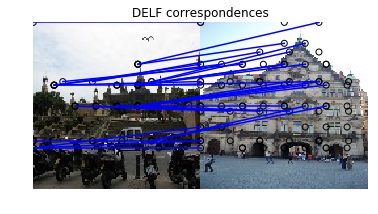

Found 33 inliers
[9633] [9633] [ True]
Found inliers for image 2774 -> 33
matched count 1


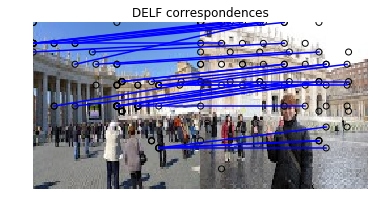

Found 44 inliers
[6051] [6051] [ True]
Found inliers for image 12808 -> 44
matched count 2


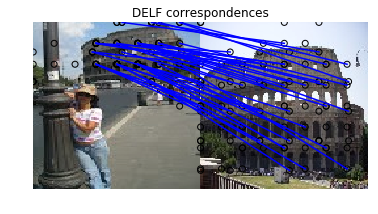

Found 60 inliers
[5554] [5554] [ True]
Found inliers for image 40949 -> 60
matched count 3


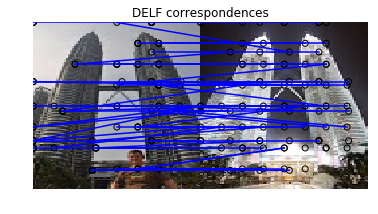

Found 26 inliers
[5554] [6696] [False]
Found inliers for image 8405 -> 26
matched count 3


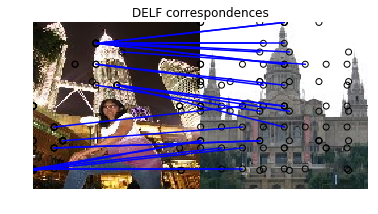

Found 41 inliers
[10577] [10577] [ True]
Found inliers for image 29441 -> 41
matched count 4


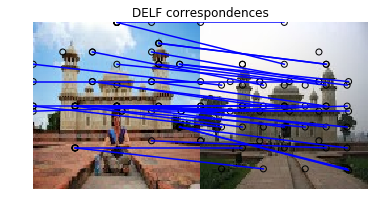

Found 27 inliers
[4644] [6051] [False]
Found inliers for image 18090 -> 27
matched count 4


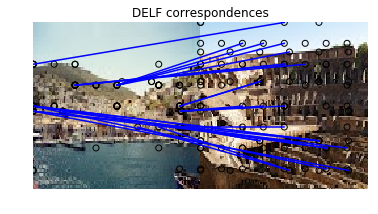

Found 32 inliers
[9029] [878] [False]
Found inliers for image 20637 -> 32
matched count 4


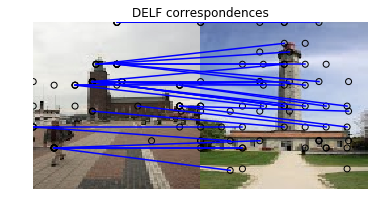

Found 37 inliers
[9779] [9779] [ True]
Found inliers for image 34727 -> 37
matched count 5


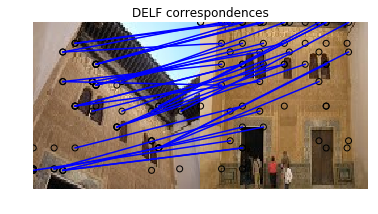

Found 30 inliers
[9633] [6051] [False]
Found inliers for image 34219 -> 30
matched count 5


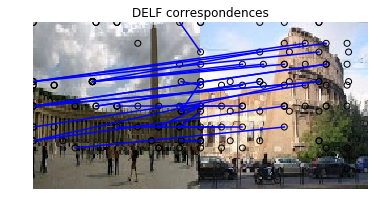

Found 29 inliers
[6651] [9633] [False]
Found inliers for image 4101 -> 29
matched count 5


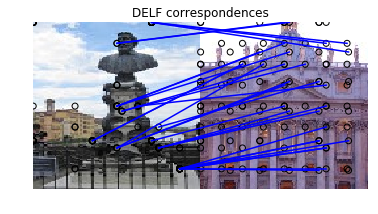

Found 34 inliers
[9605] [2870] [False]
Found inliers for image 14001 -> 34
matched count 5


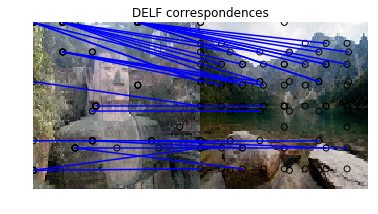

Found 30 inliers
[2061] [2061] [ True]
Found inliers for image 19990 -> 30
matched count 6


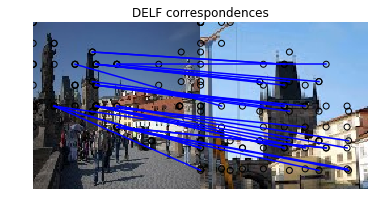

Found 56 inliers
[9633] [9633] [ True]
Found inliers for image 41057 -> 56
matched count 7


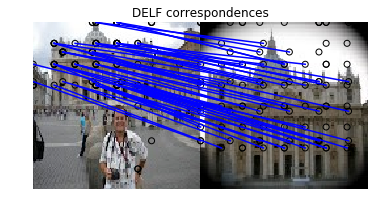

Found 39 inliers
[9633] [9633] [ True]
Found inliers for image 12229 -> 39
matched count 8


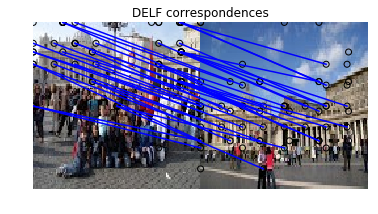

Found 26 inliers
[2949] [9779] [False]
Found inliers for image 21677 -> 26
matched count 8


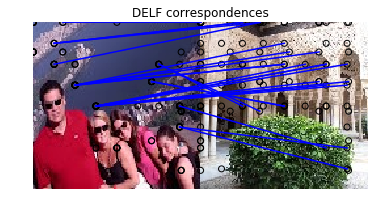

Found 30 inliers
[8063] [8063] [ True]
Found inliers for image 23699 -> 30
matched count 9


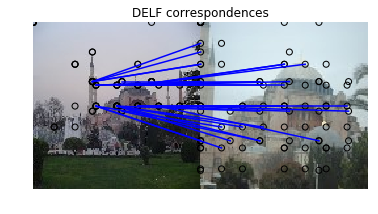

Found 41 inliers
[5554] [5554] [ True]
Found inliers for image 30791 -> 41
matched count 10


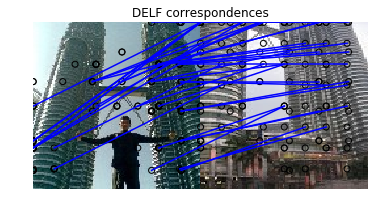

Found 57 inliers
[6051] [6051] [ True]
Found inliers for image 27581 -> 57
matched count 11


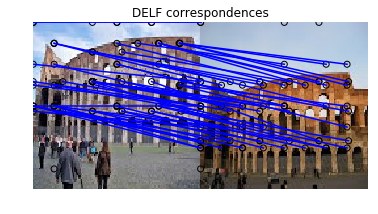

Found 31 inliers
[2044] [9029] [False]
Found inliers for image 34978 -> 31
matched count 11


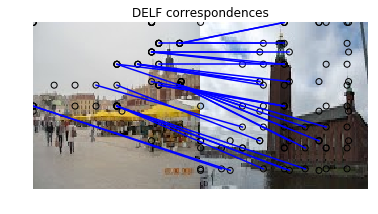

Found 27 inliers
[2338] [12172] [False]
Found inliers for image 21081 -> 27
matched count 11


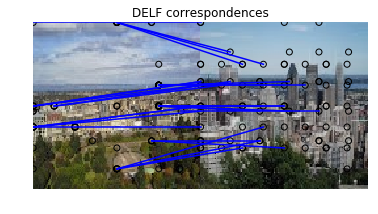

Found 26 inliers
[2743] [9633] [False]
Found inliers for image 8244 -> 26
matched count 11


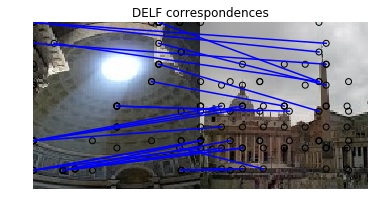

Found 26 inliers
[3497] [2743] [False]
Found inliers for image 9784 -> 26
matched count 11


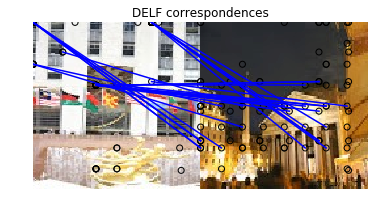

Found 32 inliers
[4981] [6051] [False]
Found inliers for image 36837 -> 32
matched count 11


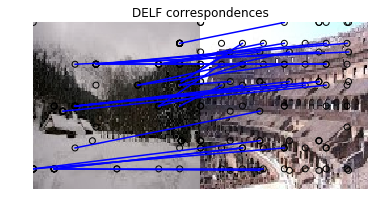

Found 41 inliers
[2061] [2061] [ True]
Found inliers for image 27502 -> 41
matched count 12


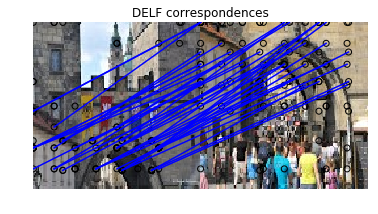

Found 31 inliers
[13876] [1553] [False]
Found inliers for image 48046 -> 31
matched count 12


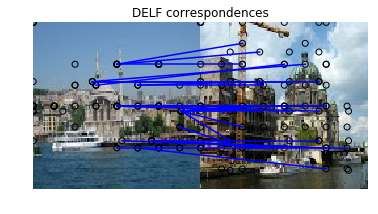

Found 27 inliers
[10900] [5554] [False]
Found inliers for image 7178 -> 27
matched count 12


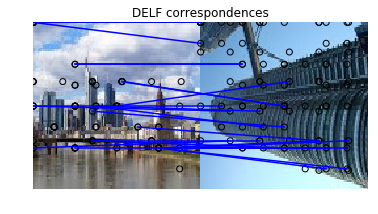

Found 33 inliers
[10577] [6597] [False]
Found inliers for image 21647 -> 33
matched count 12


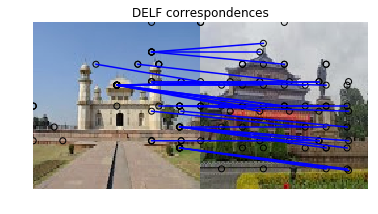

Found 30 inliers
[5554] [3497] [False]
Found inliers for image 31814 -> 30
matched count 12


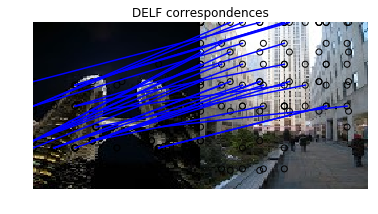

Found 32 inliers
[8063] [6231] [False]
Found inliers for image 44987 -> 32
matched count 12


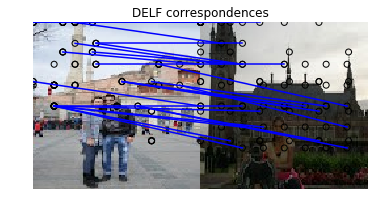

Found 31 inliers
[9779] [13594] [False]
Found inliers for image 34940 -> 31
matched count 12


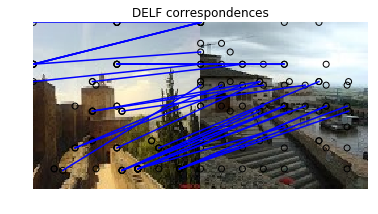

Found 41 inliers
[6051] [6051] [ True]
Found inliers for image 12808 -> 41
matched count 13


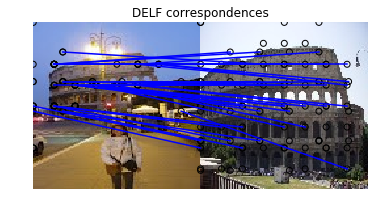

Found 48 inliers
[6051] [6051] [ True]
Found inliers for image 24063 -> 48
matched count 14


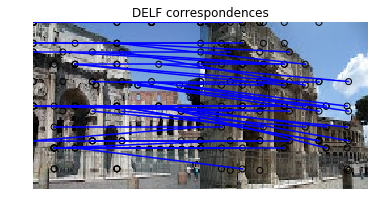

Found 28 inliers
[11784] [6051] [False]
Found inliers for image 43162 -> 28
matched count 14


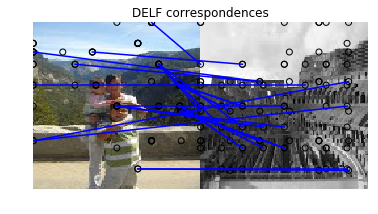

Found 29 inliers
[11371] [6051] [False]
Found inliers for image 2376 -> 29
matched count 14


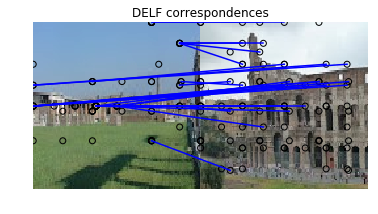

Found 59 inliers
[9633] [9633] [ True]
Found inliers for image 41057 -> 59
matched count 15


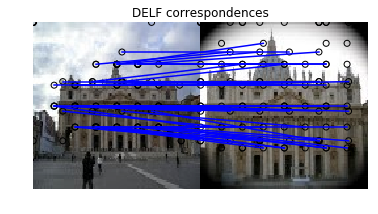

Found 24 inliers
[9633] [4987] [False]
Found inliers for image 4675 -> 24
matched count 15


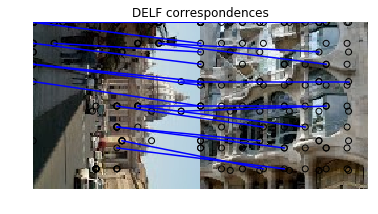

Found 25 inliers
[6051] [6051] [ True]
Found inliers for image 35203 -> 25
matched count 16


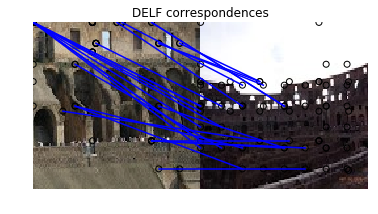

Found 27 inliers
[1946] [11249] [False]
Found inliers for image 41934 -> 27
matched count 16


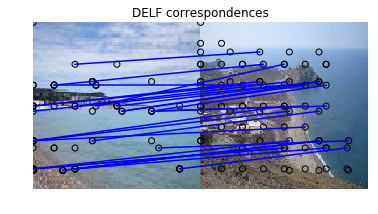

Found 35 inliers
[9633] [9633] [ True]
Found inliers for image 45272 -> 35
matched count 17


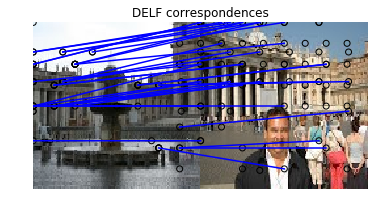

Found 28 inliers
[1472] [2061] [False]
Found inliers for image 8547 -> 28
matched count 17


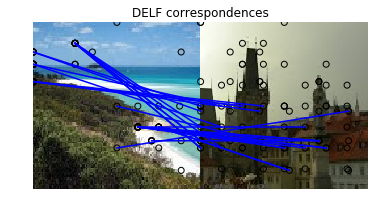

Found 25 inliers
[5460] [13876] [False]
Found inliers for image 46320 -> 25
matched count 17


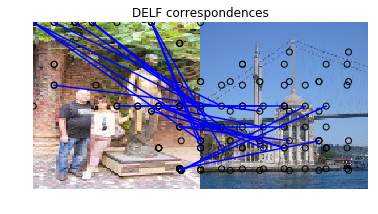

Found 37 inliers
[3130] [11249] [False]
Found inliers for image 39930 -> 37
matched count 17


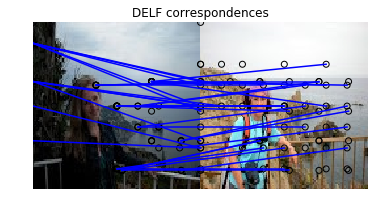

Found 29 inliers
[8429] [8063] [False]
Found inliers for image 7840 -> 29
matched count 17


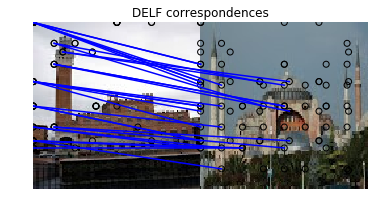

Found 29 inliers
[5166] [6051] [False]
Found inliers for image 13527 -> 29
matched count 17


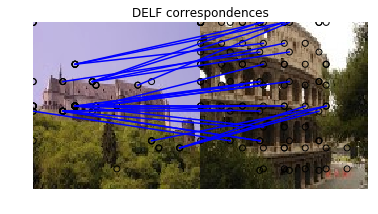

Found 26 inliers
[6651] [10184] [False]
Found inliers for image 26845 -> 26
matched count 17


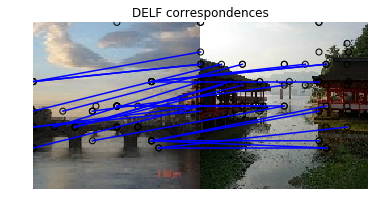

Found 40 inliers
[9779] [6051] [False]
Found inliers for image 30782 -> 40
matched count 17


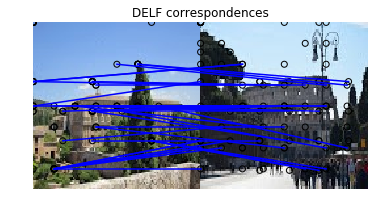

Found 34 inliers
[10045] [4352] [False]
Found inliers for image 20711 -> 34
matched count 17


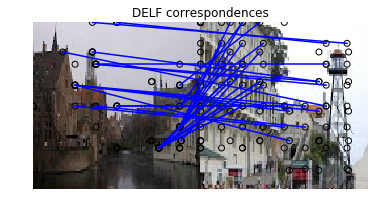

Found 27 inliers
[12220] [1878] [False]
Found inliers for image 46526 -> 27
matched count 17


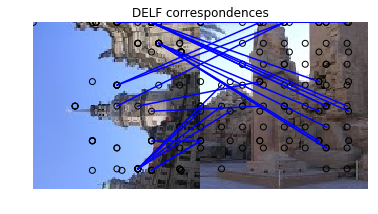

Found 35 inliers
[11371] [8063] [False]
Found inliers for image 34773 -> 35
matched count 17


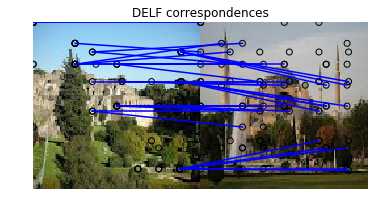

Found 30 inliers
[1878] [13526] [False]
Found inliers for image 8995 -> 30
matched count 17


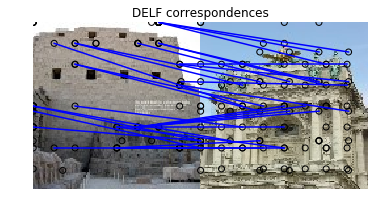

Found 48 inliers
[8429] [8429] [ True]
Found inliers for image 22545 -> 48
matched count 18


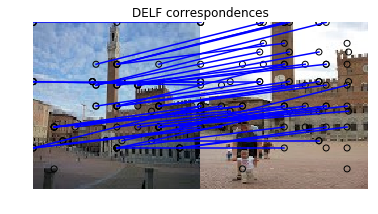

Found 34 inliers
[10511] [8063] [False]
Found inliers for image 44733 -> 34
matched count 18


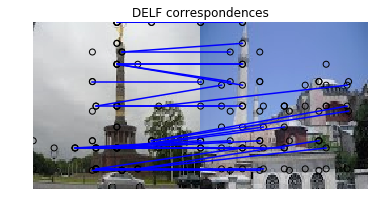

Found 37 inliers
[9779] [6051] [False]
Found inliers for image 12143 -> 37
matched count 18


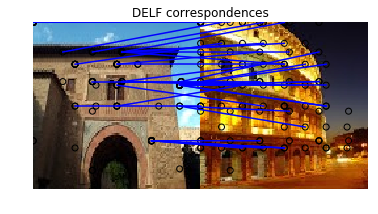

Found 34 inliers
[10026] [11784] [False]
Found inliers for image 32808 -> 34
matched count 18


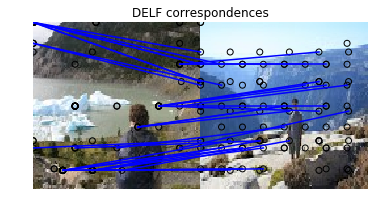

Found 33 inliers
[2061] [4085] [False]
Found inliers for image 29957 -> 33
matched count 18


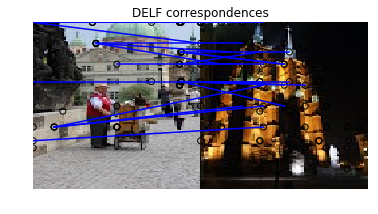

Found 28 inliers
[428] [1213] [False]
Found inliers for image 6459 -> 28
matched count 18


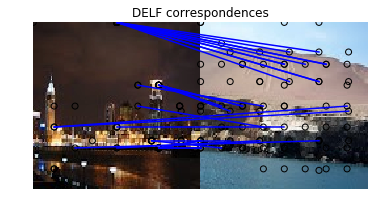

Found 30 inliers
[4352] [5421] [False]
Found inliers for image 47201 -> 30
matched count 18


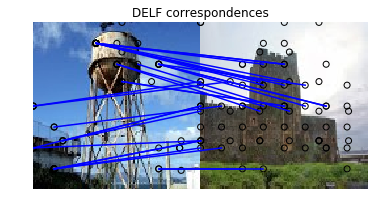

Found 30 inliers
[428] [3804] [False]
Found inliers for image 42000 -> 30
matched count 18


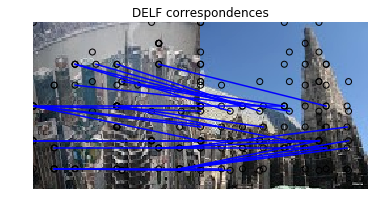

Found 28 inliers
[2338] [2338] [ True]
Found inliers for image 10479 -> 28
matched count 19


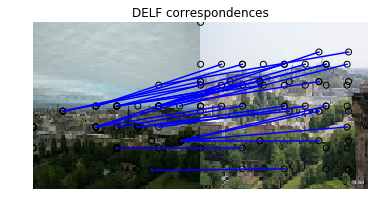

Found 35 inliers
[7041] [9633] [False]
Found inliers for image 17335 -> 35
matched count 19


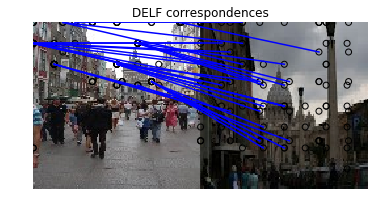

Found 23 inliers
[2061] [6051] [False]
Found inliers for image 26900 -> 23
matched count 19


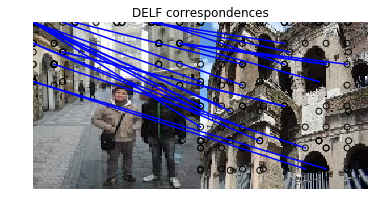

Found 29 inliers
[8429] [9633] [False]
Found inliers for image 26140 -> 29
matched count 19


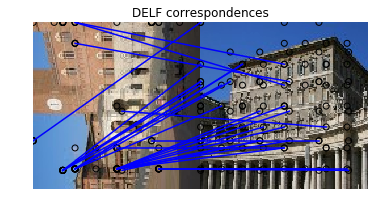

Found 30 inliers
[6599] [10033] [False]
Found inliers for image 40029 -> 30
matched count 19


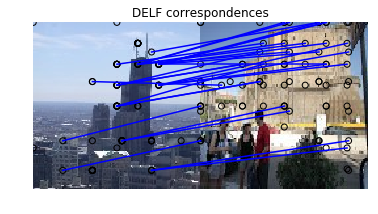

Found 31 inliers
[9633] [9633] [ True]
Found inliers for image 42718 -> 31
matched count 20


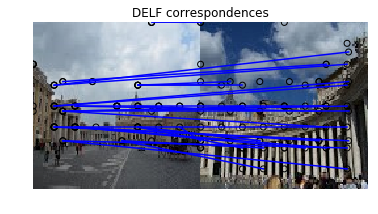

Found 27 inliers
[6051] [10184] [False]
Found inliers for image 30144 -> 27
matched count 20


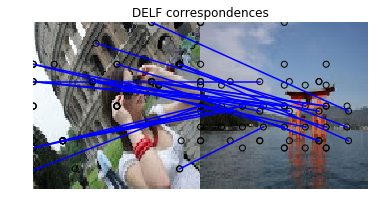

Found 28 inliers
[8429] [12220] [False]
Found inliers for image 35292 -> 28
matched count 20


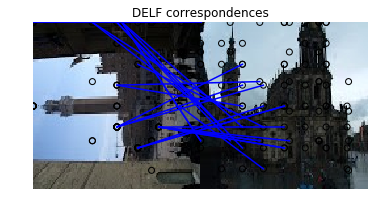

Found 31 inliers
[13526] [9779] [False]
Found inliers for image 49554 -> 31
matched count 20


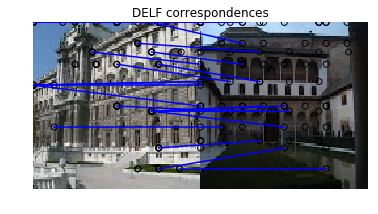

Found 30 inliers
[6051] [5376] [False]
Found inliers for image 12942 -> 30
matched count 20


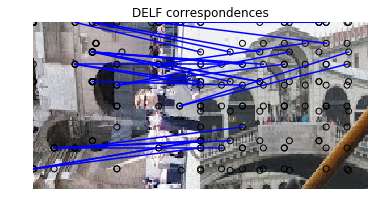

Found 37 inliers
[5376] [5376] [ True]
Found inliers for image 48363 -> 37
matched count 21


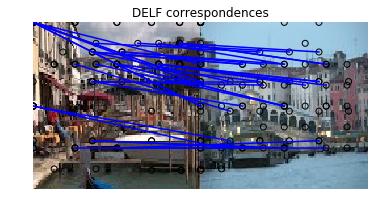

Found 31 inliers
[1553] [9633] [False]
Found inliers for image 3635 -> 31
matched count 21


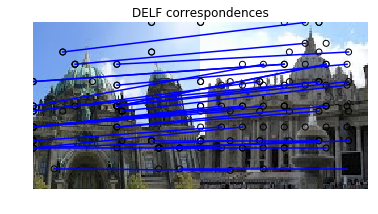

Found 27 inliers
[3804] [6051] [False]
Found inliers for image 49004 -> 27
matched count 21


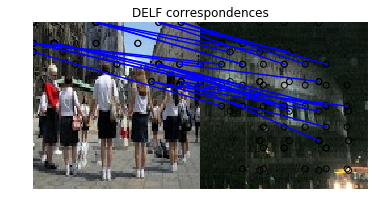

Found 30 inliers
[12718] [9779] [False]
Found inliers for image 49725 -> 30
matched count 21


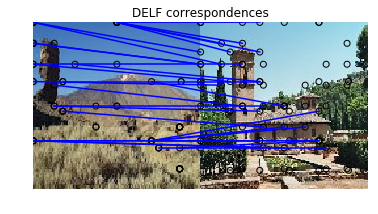

Found 32 inliers
[1553] [6051] [False]
Found inliers for image 46142 -> 32
matched count 21


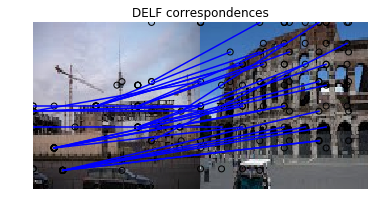

Found 41 inliers
[4987] [4987] [ True]
Found inliers for image 48685 -> 41
matched count 22


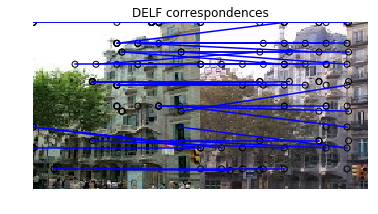

Found 32 inliers
[6599] [6599] [ True]
Found inliers for image 37737 -> 32
matched count 23


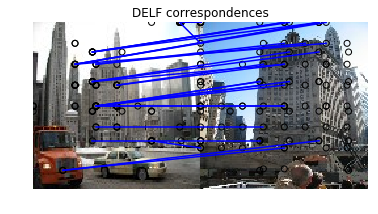

Found 40 inliers
[9633] [9633] [ True]
Found inliers for image 41057 -> 40
matched count 24


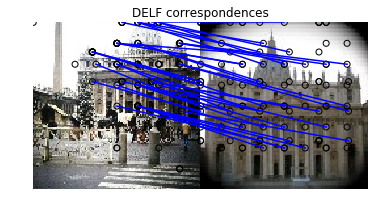

Found 30 inliers
[6051] [6051] [ True]
Found inliers for image 47177 -> 30
matched count 25


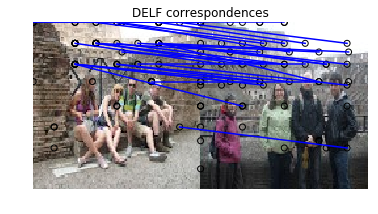

In [ ]:
results_dict1=test_features
results_dict2=train_features
distance_threshold = 1.5
matched = 0
for i in range(100):
    image_1_path = test_features.keys()[i]
    inliers_counts = []
    locations_1, descriptors_1 = results_dict1[image_1_path]    
    distances, indices = d_tree.query(descriptors_1, distance_upper_bound=distance_threshold, n_jobs=-1, k=3)

    # Find the list of unique accumulated/aggregated indexes
    unique_indices = np.array(list(set(indices.flatten())))

    unique_indices.sort()
    if unique_indices[-1] == descriptors_agg.shape[0]:
        unique_indices = unique_indices[:-1]
    unique_image_indexes = np.array(list(set([np.argmax([np.array(accumulated_indexes_boundaries)>index]) 
              for index in unique_indices])))
      
    for index in unique_image_indexes:
        image_2_path=db_images[index]

        # Read features.
        locations_1, descriptors_1 = results_dict1[image_1_path]
        num_features_1 = locations_1.shape[0]
        locations_2, descriptors_2 = results_dict2[os.path.join('apm', image_2_path)]
        num_features_2 = locations_2.shape[0]
        #print("Loaded image 2's %d features" % num_features_2)

        # Find nearest-neighbor matches using a KD tree.
        d1_tree = cKDTree(descriptors_1)
        _, indices = d1_tree.query(
            descriptors_2, distance_upper_bound=distance_threshold)

      # Select feature locations for putative matches.
        locations_2_to_use = np.array([
        locations_2[i,]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])
        locations_1_to_use = np.array([
        locations_1[indices[i],]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])

      # Perform geometric verification using RANSAC.
   
        _, inliers = ransac(
        (locations_1_to_use, locations_2_to_use),
        AffineTransform,
        min_samples=3,
        residual_threshold=20,
        max_trials=1000)
        # the number of inliers as the score for retrieved images.
        
        inliers_counts.append({"index": index, "inliers": sum(inliers)})

    top_match = sorted(inliers_counts, key=lambda k: k['inliers'], reverse=True)[0]
    index = top_match['index']
    inliers = top_match['inliers']
    image_2_path = db_images[index]
    locations_2, descriptors_2 = results_dict2[os.path.join('apm', db_images[index])]
    num_features_2 = locations_2.shape[0]
    # Find nearest-neighbor matches using a KD tree.
    d1_tree = cKDTree(descriptors_1)
    _, indices = d1_tree.query(
        descriptors_2, distance_upper_bound=distance_threshold)

    # Select feature locations for putative matches.
    locations_2_to_use = np.array([
        locations_2[i,]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])
    locations_1_to_use = np.array([
        locations_1[indices[i],]
        for i in range(num_features_2)
        if indices[i] != num_features_1
    ])

    # Perform geometric verification using RANSAC.
    _, inliers = ransac(
        (locations_1_to_use, locations_2_to_use),
        AffineTransform,
        min_samples=3,
        residual_threshold=20,
        max_trials=1000)
    # the number of inliers as the score for retrieved images.
    print('Found %d inliers' % sum(inliers))

    # find the true label
    mask = valid_subset['id'] == image_1_path[21:37]
    true_label = valid_subset[mask]['landmark_id'].values
        
    # find the predicted label
    mask = train_subset['id'] == db_images[index][12:28]
    predicted_label = train_subset[mask]['landmark_id'].values
    
    print true_label, predicted_label, true_label == predicted_label
    
    print('Found inliers for image {} -> {}').format(index, sum(inliers))
    if true_label == predicted_label:
        matched +=1
    print "matched count", matched
    # Visualize correspondences.
    _, ax = plt.subplots()
    img_1 = mpimg.imread(image_1_path[4:])
    img_2 = mpimg.imread(image_2_path)
    inlier_idxs = np.nonzero(inliers)[0]
    plot_matches(
        ax,
        img_1,
        img_2,
        locations_1_to_use,
        locations_2_to_use,
        np.column_stack((inlier_idxs, inlier_idxs)),
        matches_color='b')
    ax.axis('off')
    ax.set_title('DELF correspondences')
    plt.show()